# Proj1 Gradient Domain Fushion

In [1]:
from skimage.draw import polygon
from skimage.transform import resize
import numpy as np
import matplotlib.pyplot as plt
from scipy import sparse
from scipy.sparse import linalg
from tqdm import tqdm
import time
%matplotlib inline

## 1.1 Toy Problem

In [96]:
src_im = plt.imread('toy.png') / 255
h, w = src_im.shape

### Method 1

In [97]:
# very slow because matrix A is sparse
im2var = np.arange(0, h*w).reshape((h, w))
n_eq = 2*h*w-h-w+1
n_px = h*w
A = np.zeros((n_eq, n_px))
b = np.zeros(n_eq)

e = 0  # equation counter
# first objective
for y in range(h):
    for x in range(w-1):
        A[e, im2var[y, x+1]] = 1
        A[e, im2var[y, x]] = -1
        b[e] = src_im[y, x+1] - src_im[y, x]
        e += 1    
# second objective  
for x in range(w):
    for y in range(h-1):
        A[e, im2var[y+1, x]] = 1
        A[e, im2var[y, x]] = -1
        b[e] = src_im[y+1, x] - src_im[y, x]
        e += 1
# third objective
assert e == n_eq - 1
A[e, im2var[0, 0]] = 1
b[e] = src_im[0, 0]

In [35]:
v, _, _, _ = np.linalg.lstsq(A, b)

/Users/cxx/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  """Entry point for launching an IPython kernel.


[0.00135333 0.00135333 0.00135333 ... 0.00135333 0.00135333 0.00135333]


2.929663323230593e-18


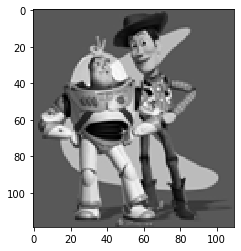

In [38]:
toy_output = v.reshape((h, w))
plt.imshow(toy_output, cmap='gray')
print(np.sum(np.square(src_im - toy_output)))

### Method 2

In [98]:
# take advantage of scipy's sparse matrix
A = sparse.csr_matrix((n_eq, n_px)).tolil()
b = np.zeros(n_eq)

y = np.repeat(np.arange(h), w-1)
x = np.tile(np.arange(w-1), h)
e = np.arange(h*(w-1))
A[e, im2var[y, x+1]] = 1
A[e, im2var[y, x]] = -1
b[e] = src_im[y, x+1] - src_im[y, x]

x = np.repeat(np.arange(w), h-1)
y = np.tile(np.arange(h-1), w)
e = np.arange(w*(h-1)) + h*(w-1)
A[e, im2var[y+1, x]] = 1
A[e, im2var[y, x]] = -1
b[e] = src_im[y+1, x] - src_im[y, x]

v = linalg.lsqr(A.tocsr(), b)[0]

0.03660415501363971


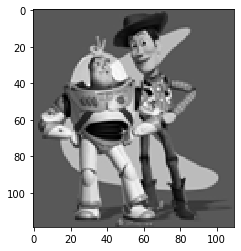

In [99]:
toy_output = v.reshape((h, w))
plt.imshow(toy_output, cmap='gray')
print(np.sum(np.square(src_im - toy_output)))

## 1.2 Poisson Blending

In [2]:
def get_points(im, num_pts=None):
    print('Please select points on image.')
    plt.imshow(im)
    pts = np.array(plt.ginput(num_pts if num_pts else 100, timeout=0, mouse_pop=None, mouse_stop=3))
    plt.close()
    pts = np.roll(pts, shift=1, axis=1)
    return pts

class Blend():
    def __init__(self, n):
        self.n = n
        %matplotlib qt
        im_size = (1500, 2000)
        self.src_im = resize(plt.imread('src' + str(n) + '.jpeg') / 255, im_size) 
        self.target_im = resize(plt.imread('target' + str(n) +'.jpeg') / 255, im_size)
        pts = get_points(self.src_im)

        self.rr, self.cc = polygon(pts[:, 0], pts[:, 1])
        self.mask_xy = np.array([self.rr, self.cc]).T
        self.n_v = self.mask_xy.shape[0]
        print('number of variables: ', self.mask_xy.shape[0])
        self.mask = np.zeros(self.src_im.shape)
        self.mask[self.mask_xy[:, 0], self.mask_xy[:, 1]] = np.ones(3)
        self.im2var = -np.ones((self.src_im.shape[0], self.src_im.shape[1]))
        self.im2var[self.rr, self.cc] = np.arange(self.n_v)

    def getAb(self, channel, mode='poisson'):
        # im in 2 dims
        n_eq = 4*self.n_v
        A = sparse.csr_matrix((n_eq, self.n_v)).tolil()
        b = np.zeros(n_eq)

        for i in tqdm(range(self.n_v)):
            row = self.mask_xy[i, 0]
            column = self.mask_xy[i, 1]

            cnt = 0
            for nb in np.array([[1, 0], [0, 1], [-1, 0], [0, -1]])+self.mask_xy[i].reshape(1, 2):
                A[4*i + cnt, i] = 1

                if mode == 'poisson':
                    diff = self.src_im[row, column, channel] - self.src_im[nb[0], nb[1], channel]
                else:
                    assert mode == 'mixed', 'Not implemented blend method'
                    diff_src = self.src_im[row, column, channel] - self.src_im[nb[0], nb[1], channel]
                    diff_target = self.target_im[row, column, channel] - self.target_im[nb[0], nb[1], channel]
                    if abs(diff_src) > abs(diff_target):
                        diff = diff_src
                    else:
                        diff = diff_target
                var_idx = self.im2var[nb[0], nb[1]]
                if  var_idx != -1:
                    A[4*i + cnt, var_idx] = -1
                    b[4*i + cnt] = diff
                else:
                    b[4*i + cnt] = self.target_im[nb[0], nb[1], channel] + diff
                cnt += 1
        return A, b

    def blend(self, mode='poisson'):
        print('Creating A & b for 3 channels...')
        time.sleep(0.2)
        Ab_list = [self.getAb(channel=i, mode=mode) for i in range(3)]
        A_list = [Ab_list[i][0] for i in range(len(Ab_list))]
        b_list = [Ab_list[i][1] for i in range(len(Ab_list))]
        print('Solving least square...')
        A = sparse.block_diag(A_list)
        b = np.concatenate(b_list)
        v = linalg.lsqr(A.tocsr(), b)[0]
        v = v.reshape((3, -1)).T
        print('done!')
        self.blended_im = self.target_im.copy()
        self.blended_im[self.rr, self.cc] = v
        
    def show(self, save=True):
        %matplotlib inline
        plt.figure(figsize=(40, 30))
        plt.subplot(2, 2, 1)
        plt.imshow(self.src_im)
        plt.title('source image')
        plt.subplot(2, 2, 2)
        plt.imshow(self.target_im)
        plt.title('target image')
        plt.subplot(2, 2, 3)
        plt.imshow(self.mask)
        plt.title('mask')
        plt.subplot(2, 2, 4)
        plt.imshow(self.blended_im)
        plt.title('blended image')
        if save:
            plt.savefig('result' + str(self.n) + '.jpg', bbox_inches='tight', pad_inches=0.5)
    
    
#     plt.figure(figsize=(20, 15))
#     plt.imshow(blended_im)
#     plt.savefig('poison' + str(n) + '.2.jpg', bbox_inches='tight', pad_inches=0.5)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Please select points on image.
number of variables:  50742
Creating A & b for 3 channels...


100%|██████████| 50742/50742 [00:05<00:00, 8678.55it/s]


Solving least square...


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


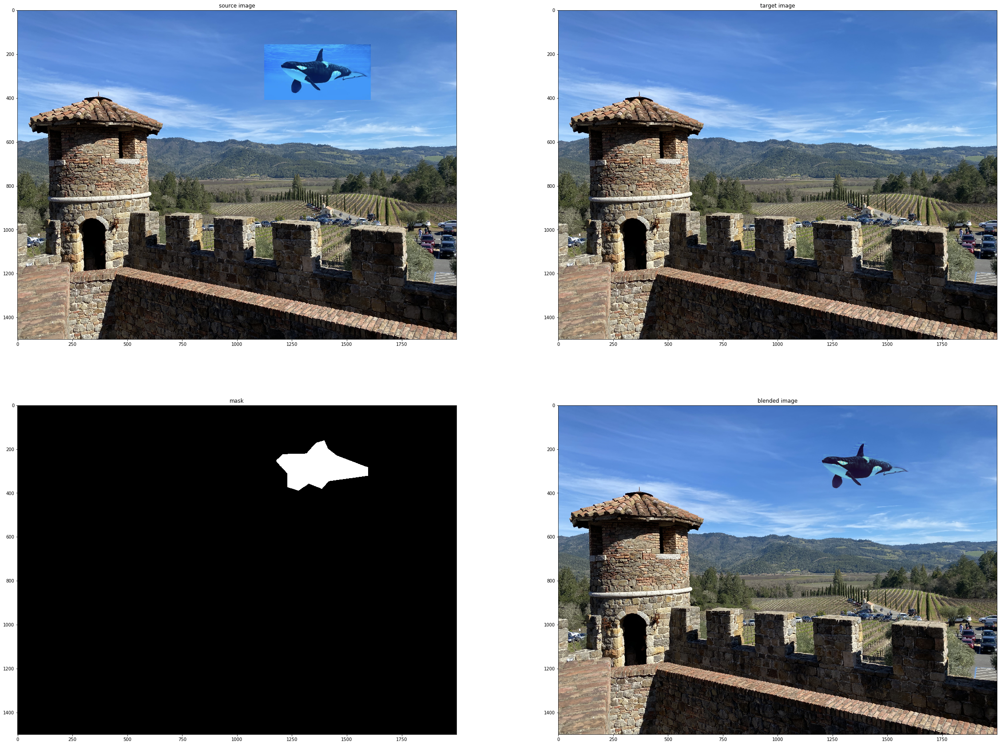

In [4]:
blend_obj = Blend(n=1)
blend_obj.blend()
blend_obj.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Please select points on image.
number of variables:  122523
Creating A & b for 3 channels...


100%|██████████| 122523/122523 [00:13<00:00, 9306.47it/s]


Solving least square...
done!


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


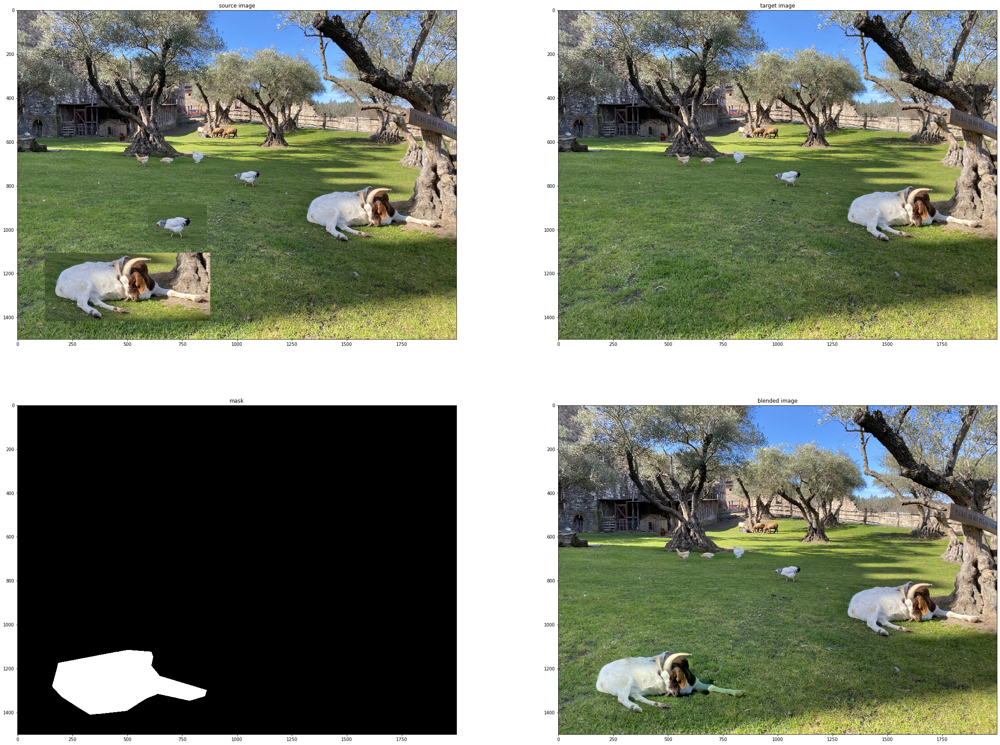

In [53]:
blend_obj = Blend(n=2)
blend_obj.blend()
blend_obj.show()

In [56]:
plt.imsave('target3.jpeg', np.clip(blend_obj.blended_im, 0, 1))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Please select points on image.
number of variables:  14595
Creating A & b for 3 channels...


100%|██████████| 14595/14595 [00:01<00:00, 9144.42it/s]


Solving least square...


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


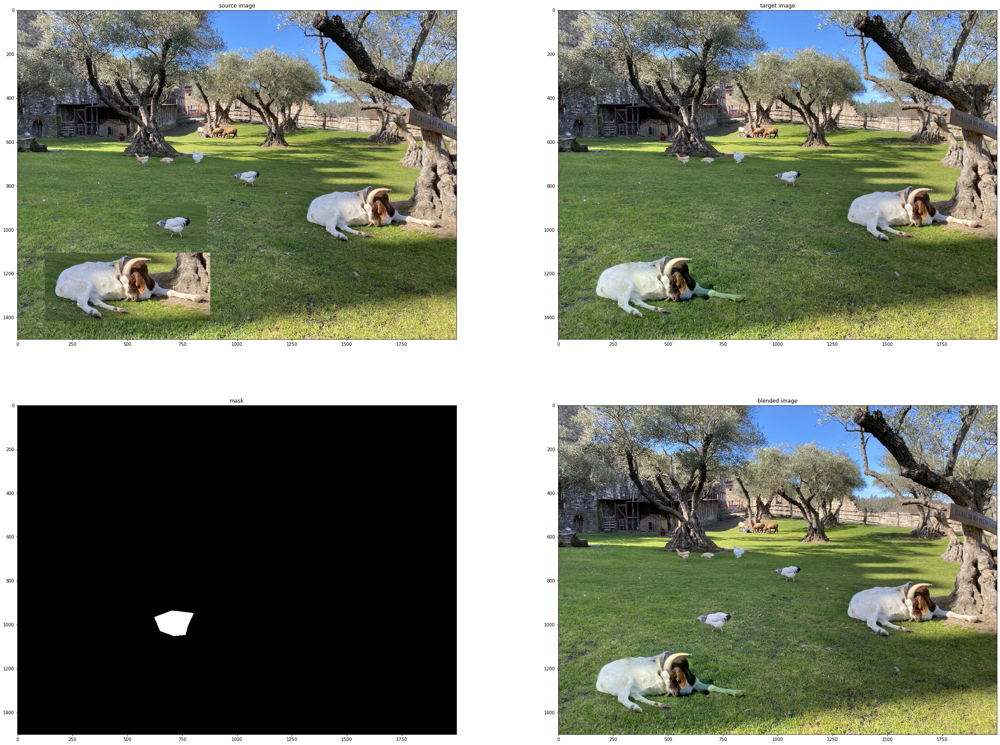

In [57]:
blend_obj = Blend(n=3)
blend_obj.blend()
blend_obj.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Please select points on image.
number of variables:  265958
Creating A & b for 3 channels...


100%|██████████| 265958/265958 [00:28<00:00, 9217.61it/s]


Solving least square...
done!


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


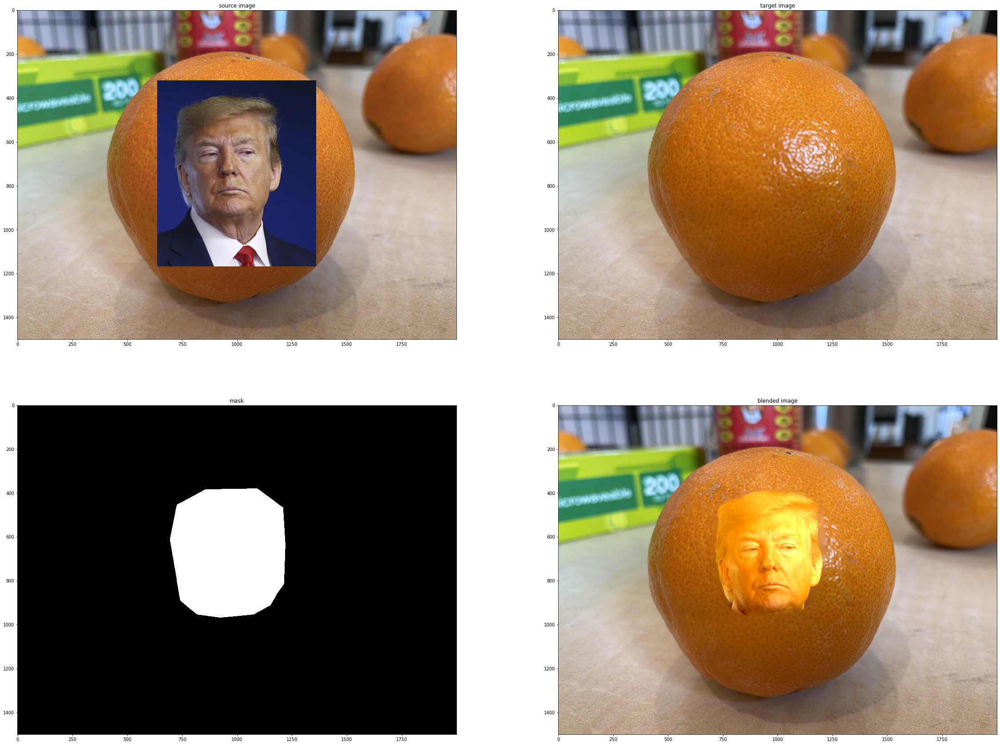

In [58]:
blend_obj = Blend(n=4)
blend_obj.blend()
blend_obj.show()

Creating A & b for 3 channels...


100%|██████████| 265958/265958 [00:30<00:00, 8769.94it/s]


Solving least square...
done!


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


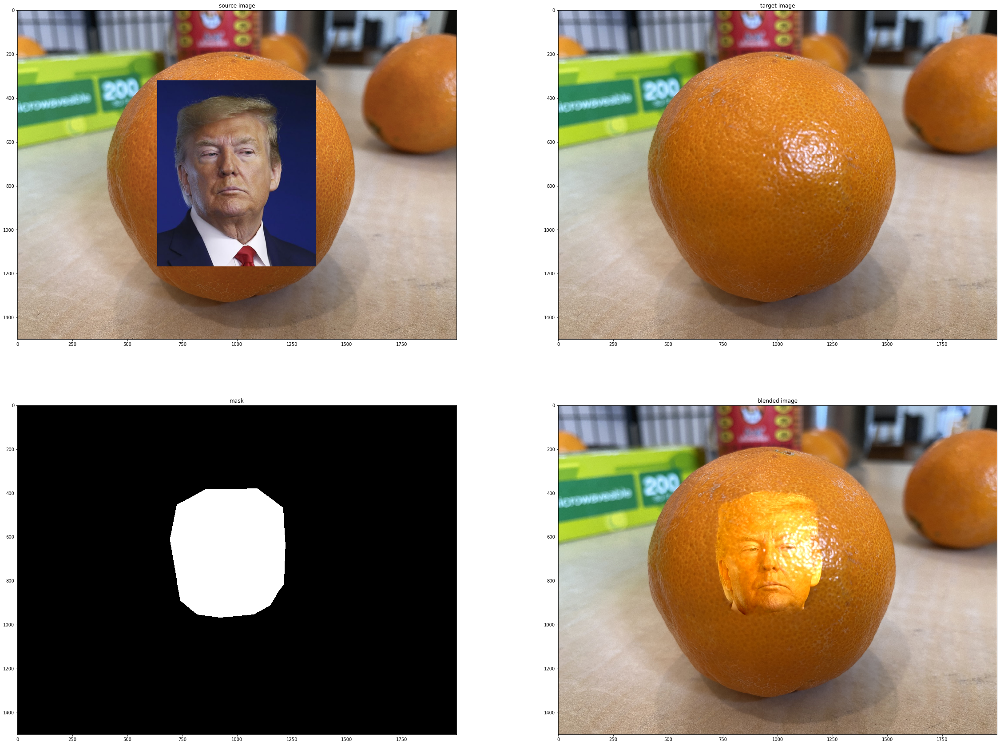

In [59]:
blend_obj.blend(mode='mixed')
blend_obj.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Please select points on image.
number of variables:  18497
Creating A & b for 3 channels...


100%|██████████| 18497/18497 [00:02<00:00, 8646.90it/s]


Solving least square...


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


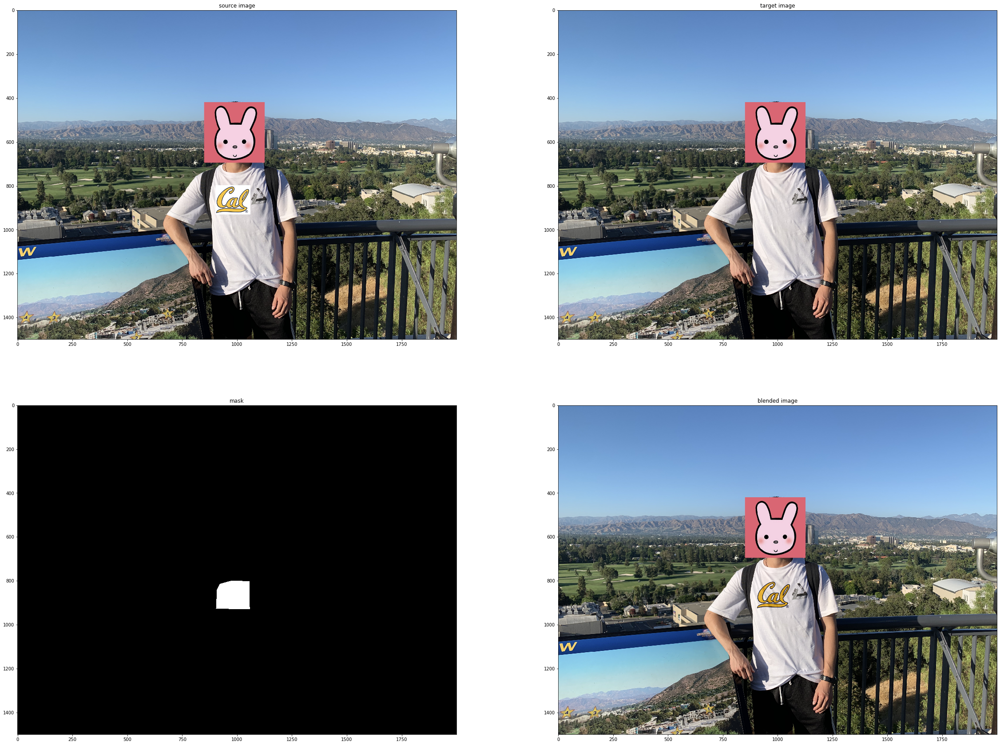

In [61]:
blend_obj = Blend(n=5)
blend_obj.blend(mode='mixed')
blend_obj.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Please select points on image.
number of variables:  298703
Creating A & b for 3 channels...


100%|██████████| 298703/298703 [00:35<00:00, 8424.29it/s]


Solving least square...
done!


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


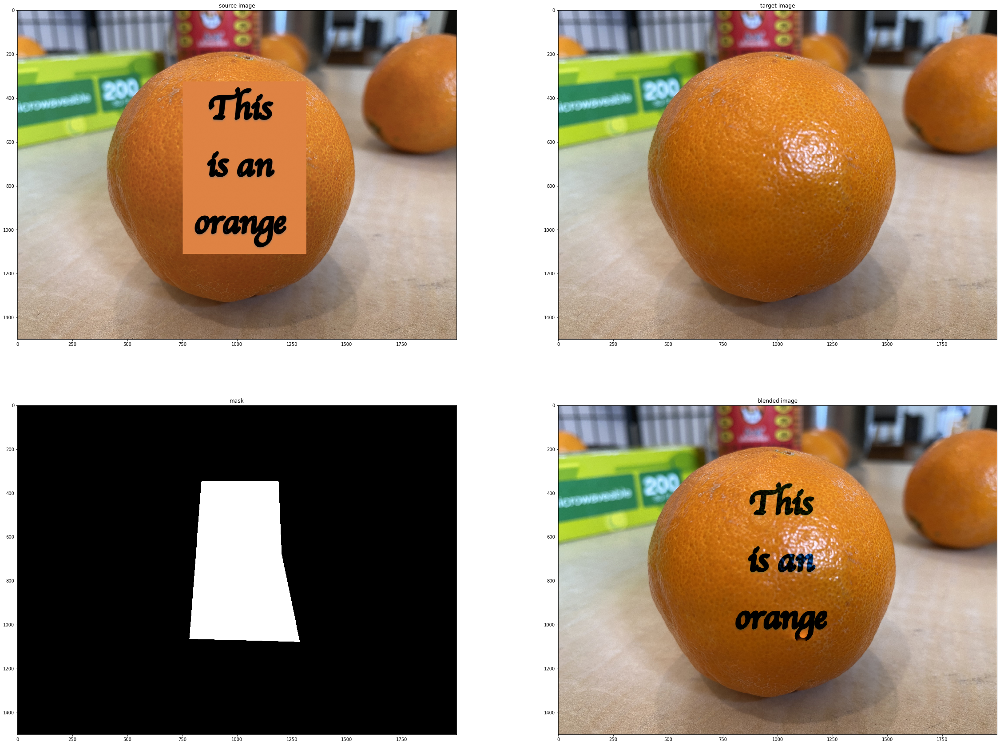

In [6]:
blend_obj = Blend(n=6)
blend_obj.blend(mode='mixed')
blend_obj.show()